# Refine tangram annotations using clustering for skin_s3

In [1]:
slide_id = "skin_s3"

In [2]:
import pandas as pd
import scanpy as sc
import spatialdata as sd
import decoupler as dc
from collections import Counter
from bioservices.kegg import KEGG

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## 1. Load the data

In [3]:
sdata = sd.read_zarr(f"/Volumes/DD_FGS/MICS/data_HE2CellType/CT_DS/sdata_tangram_annots/sdata_tangram_{slide_id}.zarr")
sdata

/var/folders/ff/llzyqd_s78v1k8vywvjxp5_r0000gn/T/ipykernel_75833/4156079343.py:1: DeprecationWarning: Table group found in zarr store at location /Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_tangram_annots/sdata_tangram_skin_s3.zarr. Please update the zarr storeto use tables instead.
  sdata = sd.read_zarr(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_tangram_annots/sdata_tangram_{slide_id}.zarr")


SpatialData object with:
├── Images
│     └── 'he': MultiscaleSpatialImage[cyx] (3, 22673, 20342), (3, 11337, 10171)
├── Points
│     └── 'st': DataFrame with shape: (23651907, 10) (3D points)
├── Shapes
│     └── 'nucleus_boundaries': GeoDataFrame shape: (106980, 1) (2D shapes)
└── Tables
      └── 'table': AnnData (106980, 541)
with coordinate systems:
▸ '_st_intrinsic', with elements:
        st (Points)
▸ 'global', with elements:
        he (Images), st (Points), nucleus_boundaries (Shapes)

In [4]:
adata_ini = sdata.table.copy()
adata_ini

/var/folders/ff/llzyqd_s78v1k8vywvjxp5_r0000gn/T/ipykernel_75833/823217089.py:1: DeprecationWarning: Table accessor will be deprecated with SpatialData version 0.1, use sdata.tables instead.
  adata_ini = sdata.table.copy()


AnnData object with n_obs × n_vars = 106980 × 541
    obs: 'region', 'slide', 'cell_id', 'area', 'ct_tangram'
    uns: 'sopa_attrs', 'spatialdata_attrs'
    obsm: 'spatial', 'tangram_pred'

In [5]:
adata_ini.obs

,region,slide,cell_id,area,ct_tangram
aaaaaaaa-1,nucleus_boundaries,morpho,aaaaaaaa-1,10.702409,Granular keratinocyte
aaaaaaab-1,nucleus_boundaries,morpho,aaaaaaab-1,7.066917,Plasma cell
aaaaaaac-1,nucleus_boundaries,morpho,aaaaaaac-1,42.537377,Mast cell
aaaaaaad-1,nucleus_boundaries,morpho,aaaaaaad-1,14.901764,APCDD1 fibroblast
aaaaaaae-1,nucleus_boundaries,morpho,aaaaaaae-1,10.476718,Proliferation T/NK
...,...,...,...,...,...
aaabkbnp-1,nucleus_boundaries,morpho,aaabkbnp-1,22.510450,Naive B
aaabkboa-1,nucleus_boundaries,morpho,aaabkboa-1,10.363265,Basal keratinocyte
aaabkbob-1,nucleus_boundaries,morpho,aaabkbob-1,16.368877,CD8 T
aaabkboc-1,nucleus_boundaries,morpho,aaabkboc-1,13.501725,APOE fibroblast


In [6]:
adata_ini.var

""
ACER1
ACHE
ACTA2
ADAM12
AHNAK2
...
UBE2C
VIM
VWF
WDFY4


## 2. Preprocessing

In [7]:
# Add transcripts counts
adata_ini.obs["transcript_counts"] = adata_ini.X.sum(axis=1)
adata_ini.obs

,region,slide,cell_id,area,ct_tangram,transcript_counts
aaaaaaaa-1,nucleus_boundaries,morpho,aaaaaaaa-1,10.702409,Granular keratinocyte,1
aaaaaaab-1,nucleus_boundaries,morpho,aaaaaaab-1,7.066917,Plasma cell,1
aaaaaaac-1,nucleus_boundaries,morpho,aaaaaaac-1,42.537377,Mast cell,175
aaaaaaad-1,nucleus_boundaries,morpho,aaaaaaad-1,14.901764,APCDD1 fibroblast,33
aaaaaaae-1,nucleus_boundaries,morpho,aaaaaaae-1,10.476718,Proliferation T/NK,2
...,...,...,...,...,...,...
aaabkbnp-1,nucleus_boundaries,morpho,aaabkbnp-1,22.510450,Naive B,46
aaabkboa-1,nucleus_boundaries,morpho,aaabkboa-1,10.363265,Basal keratinocyte,25
aaabkbob-1,nucleus_boundaries,morpho,aaabkbob-1,16.368877,CD8 T,3
aaabkboc-1,nucleus_boundaries,morpho,aaabkboc-1,13.501725,APOE fibroblast,17


<Axes: >

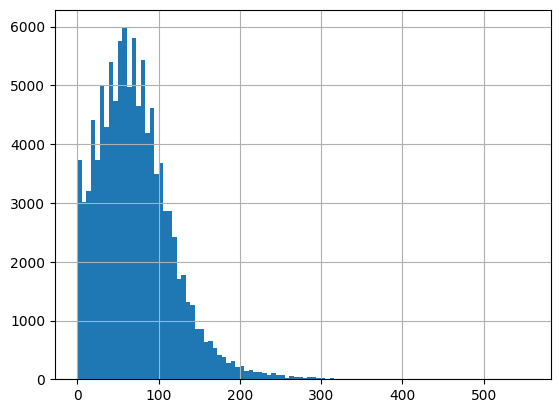

In [8]:
adata_ini.obs['transcript_counts'].hist(bins=100)

<Axes: >

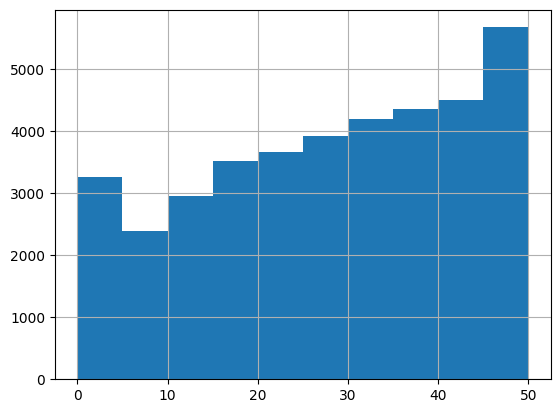

In [9]:
# in range 0-50
adata_ini.obs['transcript_counts'].hist(range=(0,50))

In [10]:
print(f"Number of cells with less than 20 transcripts: {(adata_ini.obs['transcript_counts']<20).sum()}")
print(f"Percentage of cells with less than 20 transcripts: {round(((adata_ini.obs['transcript_counts']<20).sum())/len(adata_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 15 transcripts: {(adata_ini.obs['transcript_counts']<15).sum()}")
print(f"Percentage of cells with less than 15 transcripts: {round(((adata_ini.obs['transcript_counts']<15).sum())/len(adata_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 10 transcripts: {(adata_ini.obs['transcript_counts']<10).sum()}")
print(f"Percentage of cells with less than 10 transcripts: {round(((adata_ini.obs['transcript_counts']<10).sum())/len(adata_ini.obs)*100, 2)}%")
print('-----')
print(f"Number total of cells: {len(adata_ini.obs)}")

Number of cells with less than 20 transcripts: 12138
Percentage of cells with less than 20 transcripts: 11.35%
-----
Number of cells with less than 15 transcripts: 8621
Percentage of cells with less than 15 transcripts: 8.06%
-----
Number of cells with less than 10 transcripts: 5661
Percentage of cells with less than 10 transcripts: 5.29%
-----
Number total of cells: 106980


In [11]:
adata =  adata_ini[adata_ini.obs['transcript_counts']>10].copy()
print(len(adata.obs))

100786


In [12]:
# Save the raw data
adata.layers['count'] = adata.X.copy()

In [13]:
# Normalize
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)
adata.layers['log_norm'] = adata.X.copy()

In [14]:
# Scale each gene to unit variance. Clip values exceeding standard deviation 10.
sc.pp.scale(adata, max_value=10)

## 3. Principal component analysis

In [15]:
# Reduce the dimensionality of the data by running principal component analysis (PCA), which reveals the main axes of variation and denoises the data.
sc.tl.pca(adata, svd_solver="arpack", use_highly_variable=False)

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/scanpy/preprocessing/_pca.py:374: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)


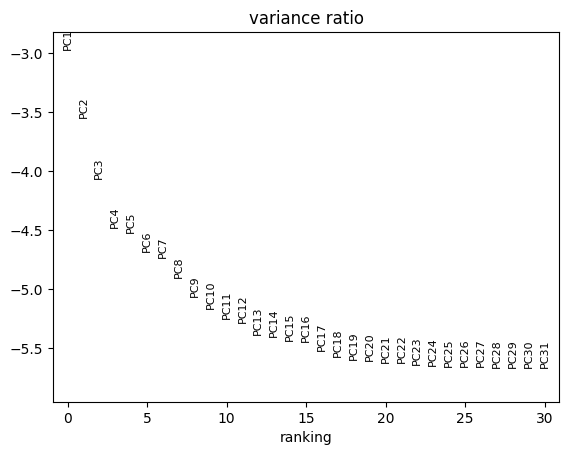

In [16]:
# Contribution of single PCs to the total variance in the data
# This gives us information about how many PCs we should consider in order to compute the neighborhood relations of cells, e.g. used in the clustering function  `sc.tl.louvain()` or tSNE `sc.tl.tsne()`
sc.pl.pca_variance_ratio(adata, log=True)

In [17]:
adata

AnnData object with n_obs × n_vars = 100786 × 541
    obs: 'region', 'slide', 'cell_id', 'area', 'ct_tangram', 'transcript_counts'
    var: 'mean', 'std'
    uns: 'sopa_attrs', 'spatialdata_attrs', 'log1p', 'pca'
    obsm: 'spatial', 'tangram_pred', 'X_pca'
    varm: 'PCs'
    layers: 'count', 'log_norm'

In [18]:
# Restore X to be log norm counts
# /!\ ALL the following analysis will use the 'log_norm' layer as input /!\
dc.swap_layer(adata, 'log_norm', X_layer_key=None, inplace=True)

## 4. The neighborhood graph + clustering

In [19]:
# Neighborhood graph of cells using the PCA representation of the data matrix
sc.pp.neighbors(adata, n_neighbors=10, n_pcs=16, use_rep="X_pca", key_added='pca_n10_pcs16')
# Embedding the neighborhood graph using UMAP
sc.tl.umap(adata, neighbors_key='pca_n10_pcs16')
# Leiden clustering directly clusters the neighborhood graph of cells
sc.tl.leiden(adata, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.2', neighbors_key='pca_n10_pcs16')
sc.tl.leiden(adata, resolution=0.4, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.4', neighbors_key='pca_n10_pcs16')
sc.tl.leiden(adata, resolution=0.6, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.6', neighbors_key='pca_n10_pcs16')

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
/var/folders/ff/llzyqd_s78v1k8vywvjxp5_r0000gn/T/ipykernel_75833/2486232371.py:6: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.2', neighbors_key='pca_n10_pcs16')


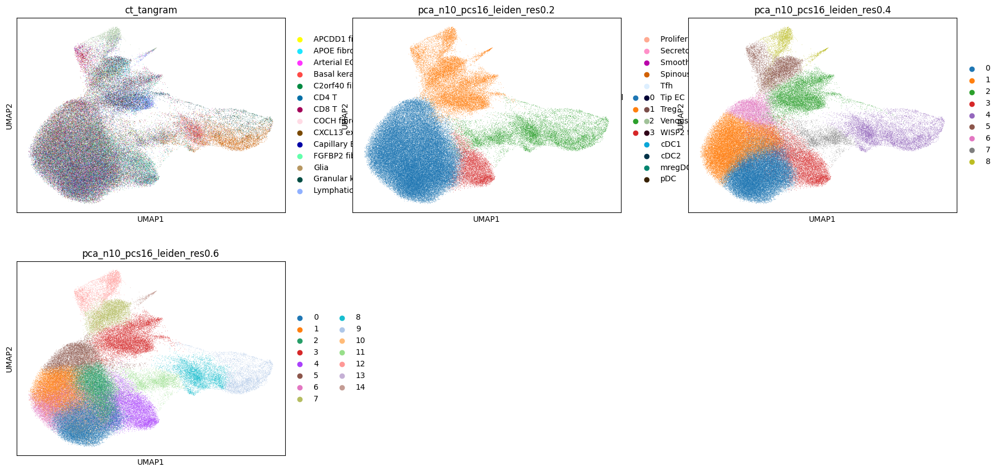

In [20]:
# Plot the clusters
sc.pl.umap(adata, neighbors_key='pca_n10_pcs16',
           color=['ct_tangram', 'pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.6'],
           ncols=3)

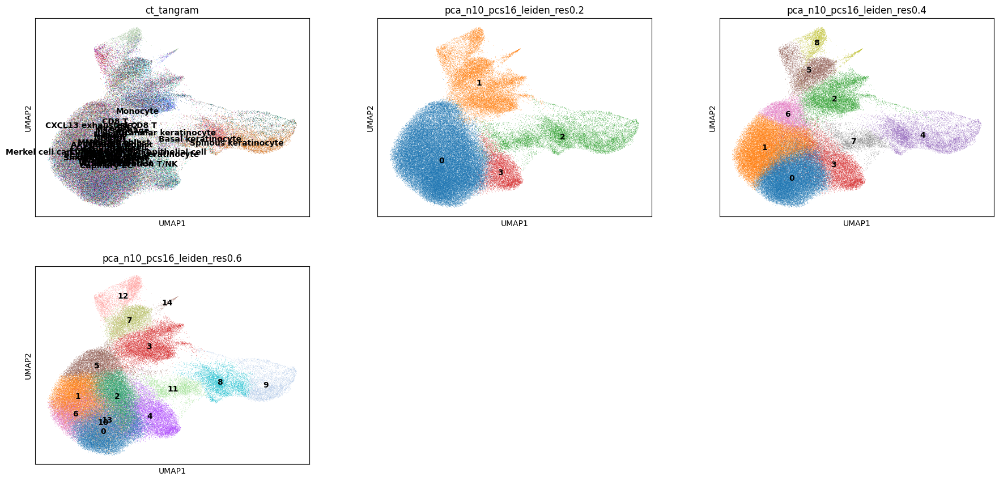

In [21]:
# Plot the clusters
sc.pl.umap(adata, neighbors_key='pca_n10_pcs16',
           color=['ct_tangram', 'pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.6'],
           ncols=3, legend_loc='on data')

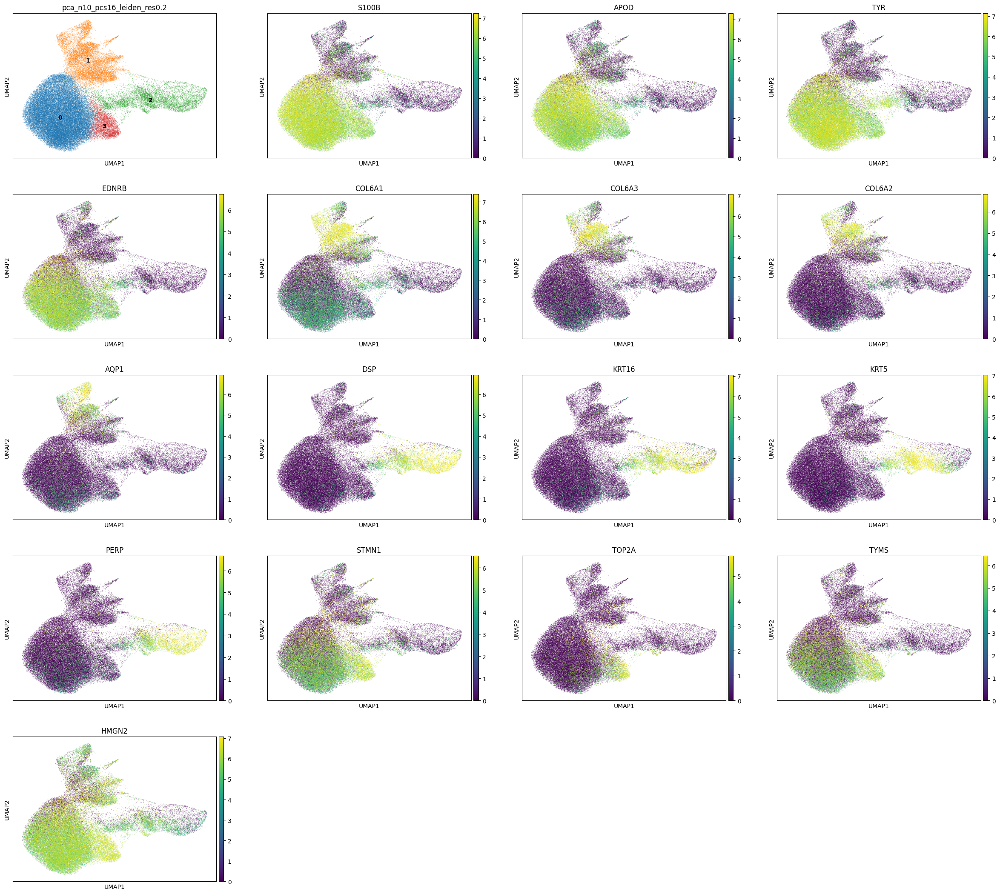

In [22]:
clustering_label = 'pca_n10_pcs16_leiden_res0.2'

# Wilcoxon rank-sum (Mann-Whitney-U) test
sc.tl.rank_genes_groups(adata, clustering_label, method="wilcoxon", corr_method="benjamini-hochberg", key_added="rank_genes_"+clustering_label)

# The 4 top ranked genes per cluster
df = pd.DataFrame(adata.uns["rank_genes_"+clustering_label]["names"]).iloc[:4, :]
list_genes = pd.concat([df[col] for col in df], ignore_index=True).tolist()
sc.pl.umap(adata, color=[clustering_label]+list_genes, vmax="p99", vmin=0, ncols=4, legend_loc='on data')

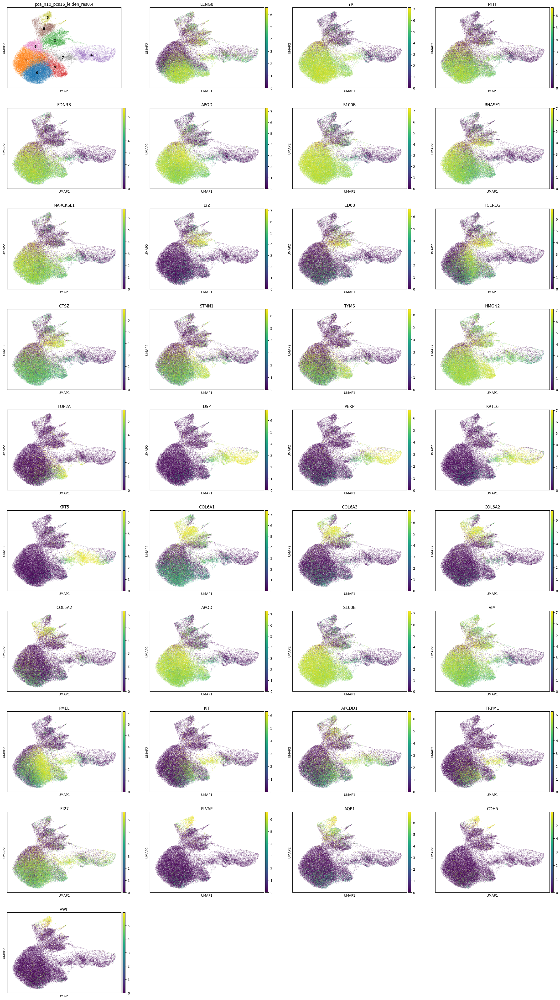

In [23]:
clustering_label = 'pca_n10_pcs16_leiden_res0.4'

# Wilcoxon rank-sum (Mann-Whitney-U) test
sc.tl.rank_genes_groups(adata, clustering_label, method="wilcoxon", corr_method="benjamini-hochberg", key_added="rank_genes_"+clustering_label)

# The 4 top ranked genes per cluster
df = pd.DataFrame(adata.uns["rank_genes_"+clustering_label]["names"]).iloc[:4, :]
list_genes = pd.concat([df[col] for col in df], ignore_index=True).tolist()
sc.pl.umap(adata, color=[clustering_label]+list_genes, vmax="p99", vmin=0, ncols=4, legend_loc='on data')

In [24]:
# Number of clusters
adata.obs['pca_n10_pcs16_leiden_res0.4'].unique()

['4', '3', '5', '0', '1', '2', '8', '6', '7']
Categories (9, object): ['0', '1', '2', '3', ..., '5', '6', '7', '8']

In [25]:
# Refine resolution
adata.obs['refine_res'] = 'att'

adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.4'].isin(['0']), 'refine_res'] = '0'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.4'].isin(['1']), 'refine_res'] = '1'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.4'].isin(['2']), 'refine_res'] = '2'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.4'].isin(['3']), 'refine_res'] = '3'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.4'].isin(['4']), 'refine_res'] = '4'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.4'].isin(['5']), 'refine_res'] = '5'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.4'].isin(['6']), 'refine_res'] = '6'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.4'].isin(['7']), 'refine_res'] = '7'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.4'].isin(['8']), 'refine_res'] = '8'

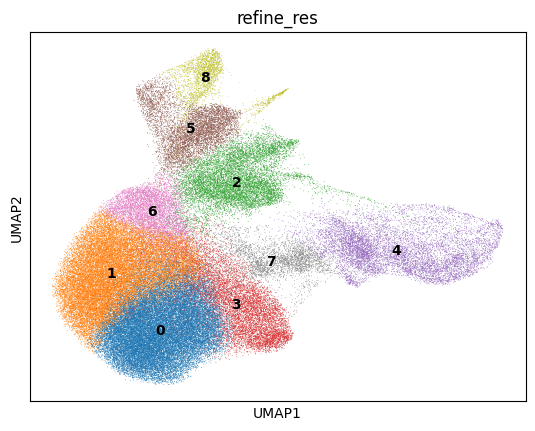

In [26]:
# Plot the clusters
sc.pl.umap(adata, neighbors_key='pca_n10_pcs16', color=['refine_res'], legend_loc='on data')

## 5. Name clusters

**To go from specific gene marker to cell type: http://xteam.xbio.top/CellMarker/search.jsp?cellMarkerSpeciesType=Human&cellMarker=CD5L**

In [27]:
clustering_label = 'refine_res'

In [28]:
def get_top_tangram_labels_for_clustering(adata, clustering_key, top_n=3):

    grouped = adata.obs.groupby(clustering_key)
    results = []
    
    for cluster, group in grouped:
        
        label_counts = Counter(group['ct_tangram'])
        total_cells = len(group)
        label_percentages = [(label, round(count / total_cells * 100)) for label, count in label_counts.items()]
        top_labels = sorted(label_percentages, key=lambda x: x[1], reverse=True)[:top_n]
        
        for label, percentage in top_labels:
            results.append({
                'Cluster': cluster,
                'Label': label,
                'Percentage': percentage
            })
    
    cluster_df = pd.DataFrame(results)
    
    return cluster_df

top_tangram = get_top_tangram_labels_for_clustering(adata, clustering_label, top_n=7)

/var/folders/ff/llzyqd_s78v1k8vywvjxp5_r0000gn/T/ipykernel_75833/3112203278.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = adata.obs.groupby(clustering_key)


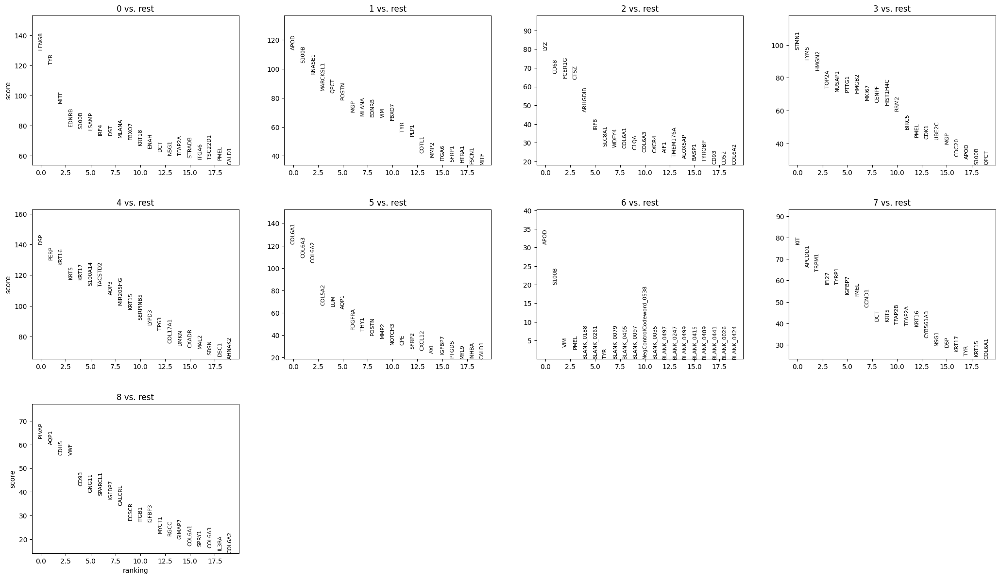

In [29]:
# Wilcoxon rank-sum (Mann-Whitney-U) test. 
# You might also consider much more powerful differential testing packages like MAST, limma, DESeq2 and, for python, the recent diffxpy.
sc.tl.rank_genes_groups(adata, clustering_label, method="wilcoxon", corr_method="benjamini-hochberg", key_added="rank_genes_"+clustering_label)
sc.pl.rank_genes_groups(adata, n_genes=20, sharey=False, key="rank_genes_"+clustering_label)

In [30]:
# The top ranked genes per cluster
top_ranked_genes = pd.DataFrame(adata.uns["rank_genes_"+clustering_label]["names"]).iloc[:5, :]
list_genes = pd.concat([top_ranked_genes[col] for col in top_ranked_genes], ignore_index=True).tolist()

In [31]:
adata.obs['label1'] = 'att'
adata.obs['label2'] = 'att'
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

### 5.1. Cluster 0

In [32]:
cluster_id = '0'

In [33]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
0,0,Venous EC,8
1,0,WISP2 fibroblast,8
2,0,APOE fibroblast,6
3,0,Capillary EC,5
4,0,Smooth muscle cell,5
5,0,Myofibroblast,5
6,0,Proliferation T/NK,4


In [34]:
top_ranked_genes[cluster_id]

0    LENG8
1      TYR
2     MITF
3    EDNRB
4    S100B
Name: 0, dtype: object

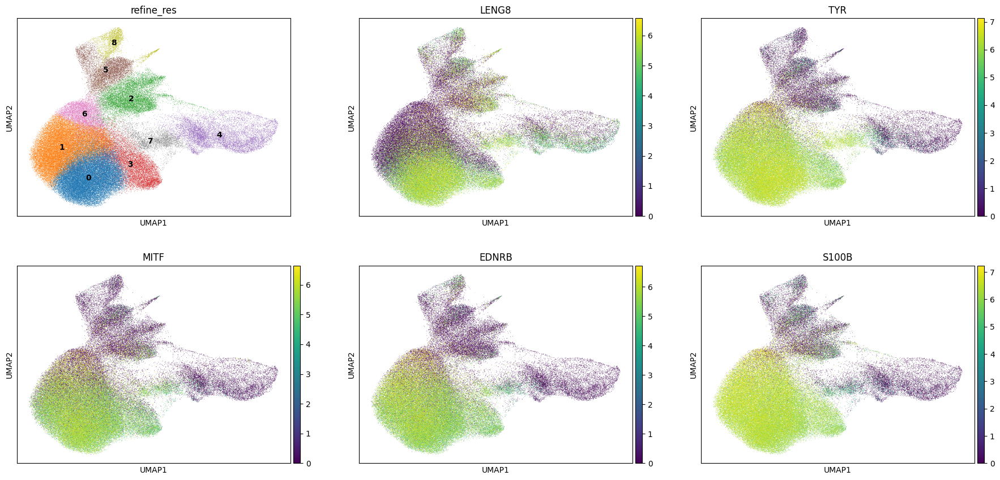

In [35]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [36]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 0: 29718
Percentage of cells in cluster 0: 29.5


In [37]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Melanocyte'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Melanocyte'

### 5.2. Cluster 1

In [38]:
cluster_id = '1'

In [39]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
7,1,WISP2 fibroblast,5
8,1,Tip EC,5
9,1,FGFBP2 fibroblast,5
10,1,Secretory cell,4
11,1,Arterial EC,4
12,1,APOE fibroblast,4
13,1,Capillary EC,4


In [40]:
top_ranked_genes[cluster_id]

0        APOD
1       S100B
2      RNASE1
3    MARCKSL1
4        QPCT
Name: 1, dtype: object

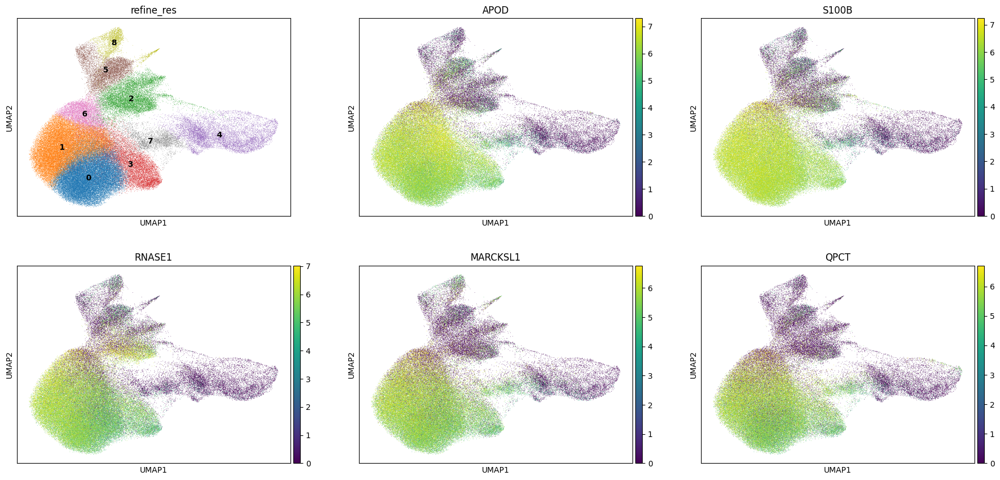

In [41]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [42]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 1: 25360
Percentage of cells in cluster 1: 25.2


In [43]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Melanocyte'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Melanocyte'

### 5.3. Cluster 2

In [44]:
cluster_id = '2'

In [45]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
14,2,Monocyte,17
15,2,cDC2,10
16,2,CD8 T,7
17,2,Macrophage,7
18,2,Treg,6
19,2,Proliferation T/NK,5
20,2,mregDC,4


In [46]:
top_ranked_genes[cluster_id]

0        LYZ
1       CD68
2     FCER1G
3       CTSZ
4    ARHGDIB
Name: 2, dtype: object

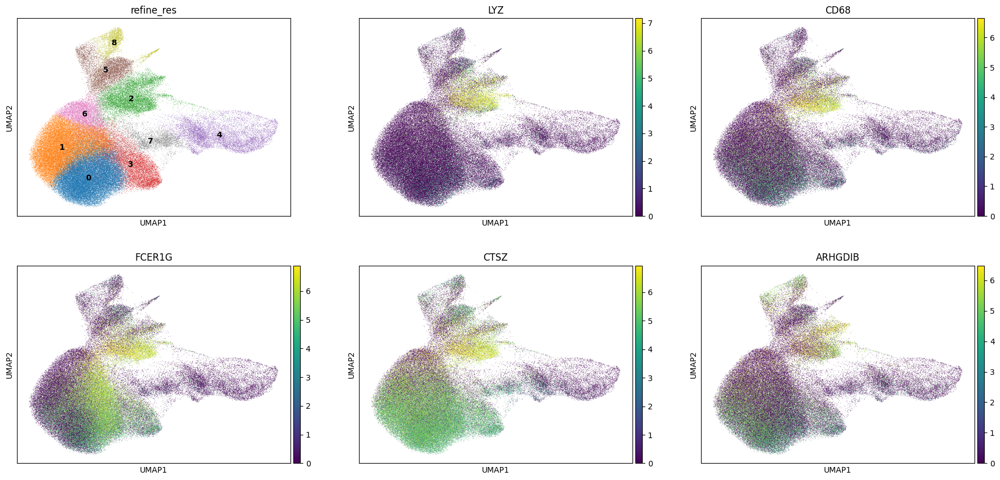

In [47]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [49]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 2: 9644
Percentage of cells in cluster 2: 9.6


In [50]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Monocyte/Macrophage/DC'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Monocyte/Macrophage/DC'

### 5.4. Cluster 3

In [51]:
cluster_id = '3'

In [52]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
21,3,Proliferation T/NK,19
22,3,Venous EC,6
23,3,Proliferation keratinocyte,6
24,3,WISP2 fibroblast,6
25,3,APOE fibroblast,4
26,3,Capillary EC,4
27,3,Smooth muscle cell,3


In [53]:
top_ranked_genes[cluster_id]

0     STMN1
1      TYMS
2     HMGN2
3     TOP2A
4    NUSAP1
Name: 3, dtype: object

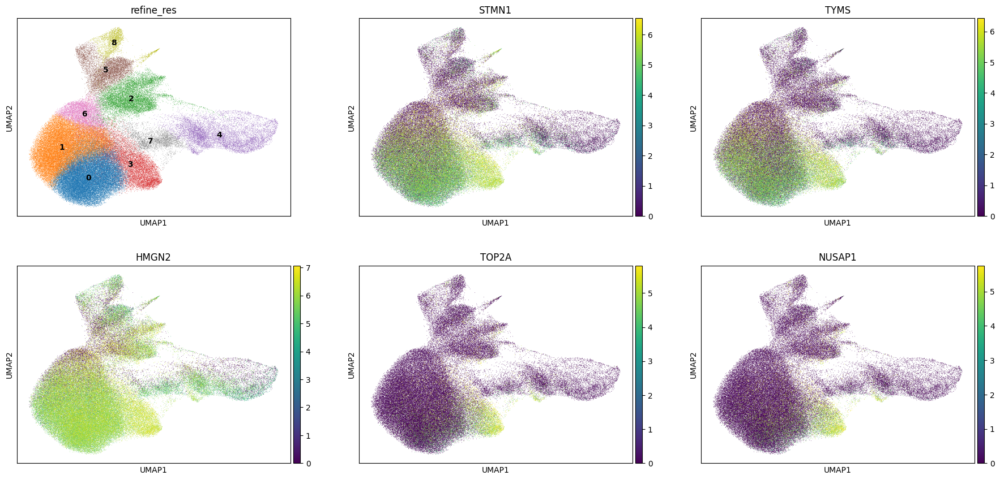

In [54]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [55]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 3: 9403
Percentage of cells in cluster 3: 9.3


In [56]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Melanocyte'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'High_proliferating_melanocyte'

### 5.5. Cluster 4

In [57]:
cluster_id = '4'

In [58]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
28,4,Spinous keratinocyte,44
29,4,Basal keratinocyte,14
30,4,Granular keratinocyte,13
31,4,Mast cell,4
32,4,Proliferation T/NK,2
33,4,WISP2 fibroblast,2
34,4,Pericyte,2


In [59]:
top_ranked_genes[cluster_id]

0      DSP
1     PERP
2    KRT16
3     KRT5
4    KRT17
Name: 4, dtype: object

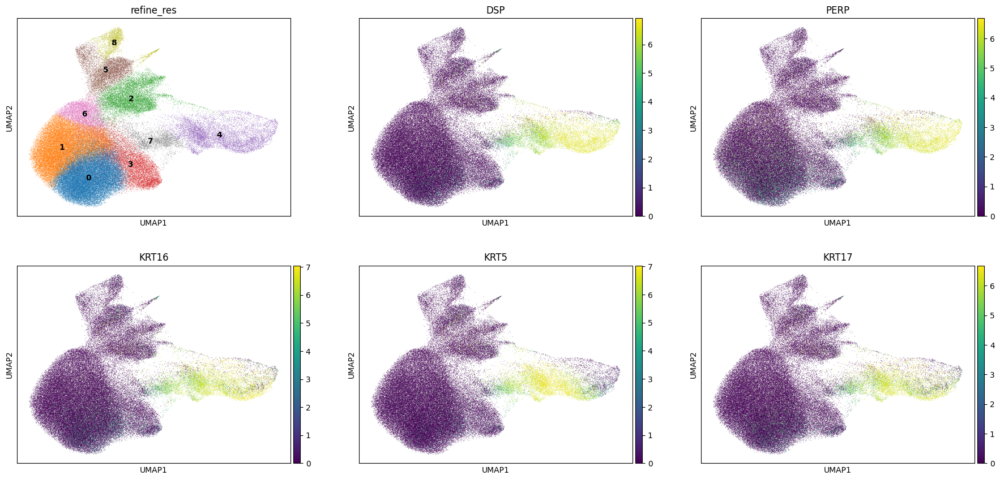

In [60]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [61]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 4: 8785
Percentage of cells in cluster 4: 8.7


In [62]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Keratinocyte'

### 5.6. Cluster 5

In [63]:
cluster_id = '5'

In [64]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
35,5,WISP2 fibroblast,15
36,5,APOE fibroblast,14
37,5,Pericyte,9
38,5,Myofibroblast,9
39,5,Smooth muscle cell,8
40,5,MMP1 fibroblast,6
41,5,Venous EC,4


In [65]:
top_ranked_genes[cluster_id]

0    COL6A1
1    COL6A3
2    COL6A2
3    COL5A2
4       LUM
Name: 5, dtype: object

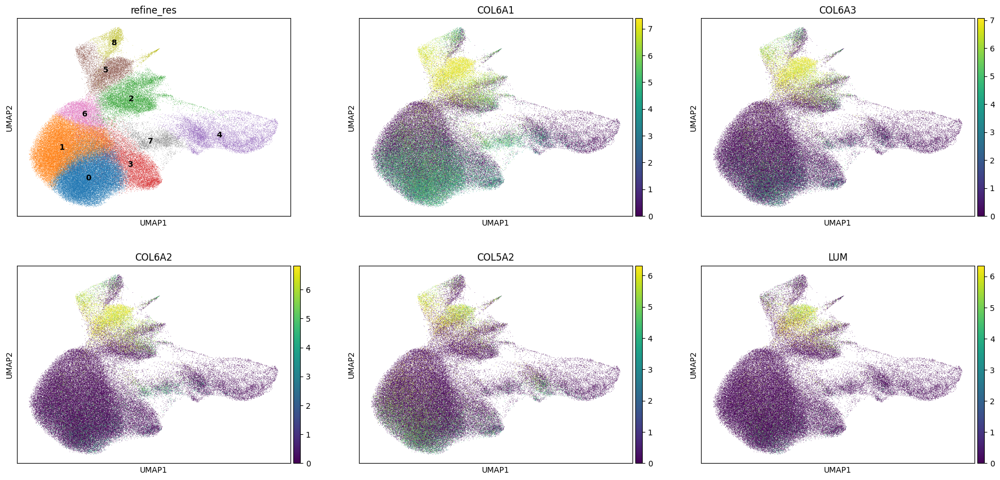

In [66]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [67]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 5: 6388
Percentage of cells in cluster 5: 6.3


In [70]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Fibroblast'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'CAF'

### 5.7. Cluster 6

In [71]:
cluster_id = '6'

In [72]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
42,6,CXCL13 exhausted CD8 T,11
43,6,CD8 T,7
44,6,COCH fibroblast,6
45,6,CD4 T,4
46,6,Lymphatic EC,4
47,6,NK cell,4
48,6,Treg,4


In [73]:
top_ranked_genes[cluster_id]

0          APOD
1         S100B
2           VIM
3          PMEL
4    BLANK_0188
Name: 6, dtype: object

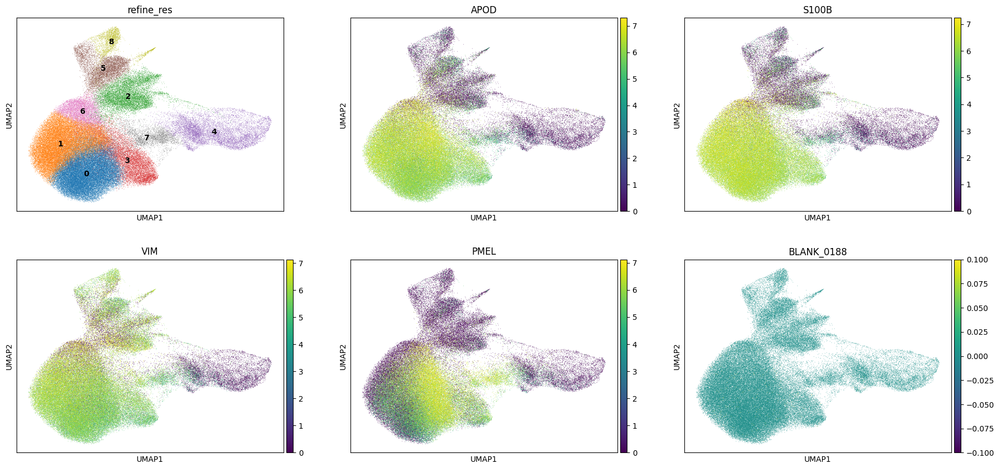

In [74]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [75]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 6: 5719
Percentage of cells in cluster 6: 5.7


In [76]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Melanocyte'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Melanocyte'

### 5.8. Cluster 7

In [77]:
cluster_id = '7'

In [78]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
49,7,Mast cell,18
50,7,Spinous keratinocyte,11
51,7,Melanocyte,5
52,7,Venous EC,4
53,7,Proliferation T/NK,4
54,7,Capillary EC,4
55,7,Myofibroblast,3


In [79]:
top_ranked_genes[cluster_id]

0       KIT
1    APCDD1
2     TRPM1
3     IFI27
4     TYRP1
Name: 7, dtype: object

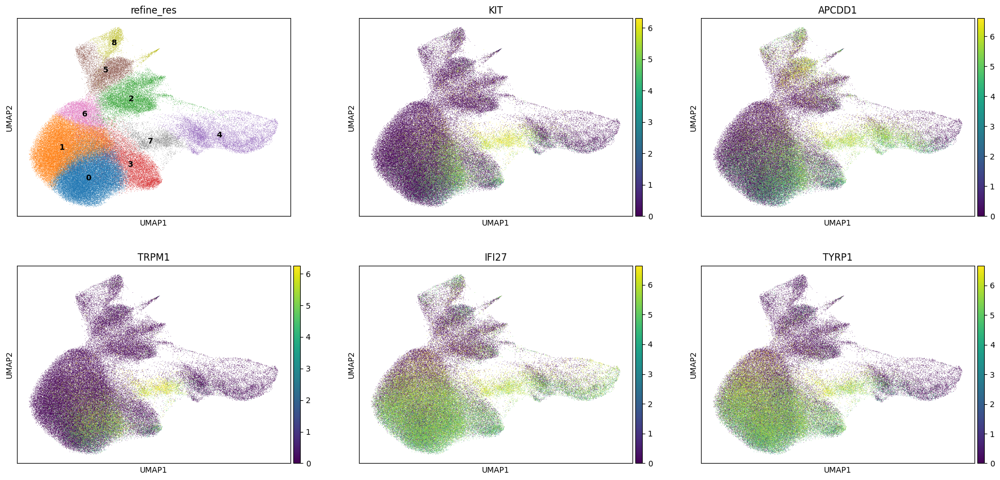

In [80]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [81]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 7: 3433
Percentage of cells in cluster 7: 3.4


In [82]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Melanocyte'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Melanocyte'

### 5.9. Cluster 8

In [83]:
cluster_id = '8'

In [84]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
56,8,Venous EC,69
57,8,Capillary EC,7
58,8,Lymphatic EC,6
59,8,Arterial EC,4
60,8,Plasma cell,1
61,8,Smooth muscle cell,1
62,8,Pericyte,1


In [85]:
top_ranked_genes[cluster_id]

0    PLVAP
1     AQP1
2     CDH5
3      VWF
4     CD93
Name: 8, dtype: object

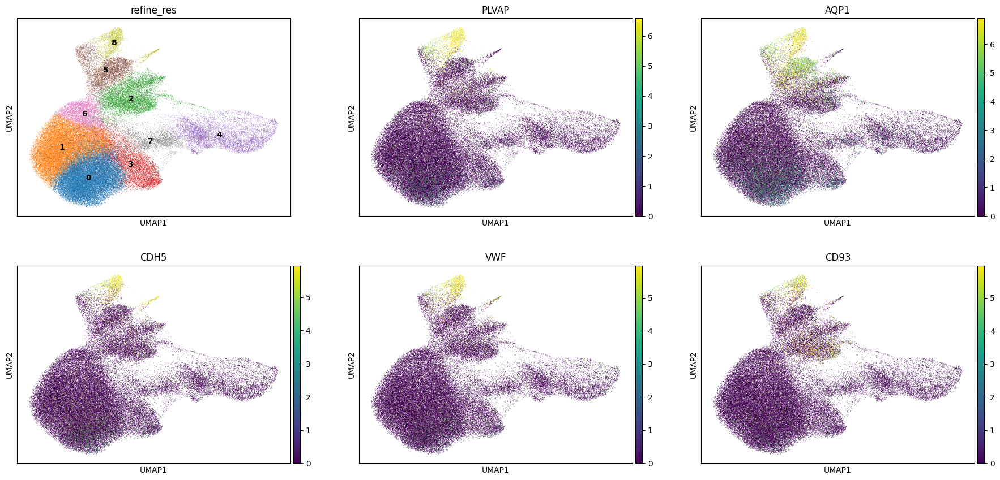

In [86]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [87]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 8: 2336
Percentage of cells in cluster 8: 2.3


In [88]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Endothelial'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Endothelial'

## 6. Cancer cells

In [91]:
adata.obs['label1'].unique()

array(['Epithelial', 'Melanocyte', 'Fibroblast', 'Monocyte/Macrophage/DC',
       'Endothelial'], dtype=object)

In [92]:
adata.obs['label2'].unique()

array(['Keratinocyte', 'High_proliferating_melanocyte', 'CAF',
       'Melanocyte', 'Monocyte/Macrophage/DC', 'Endothelial'],
      dtype=object)

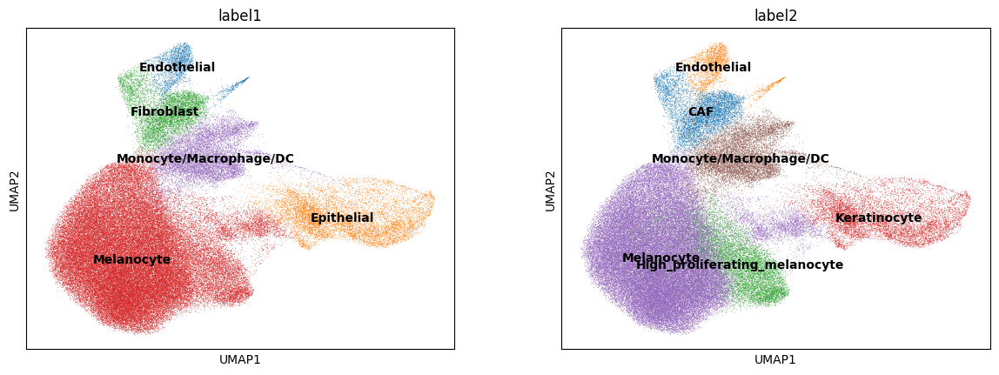

In [93]:
sc.pl.umap(adata, color=['label1', 'label2'], vmax="p99", vmin=0, ncols=4, legend_loc='on data')

In [95]:
# Pathway analysis using KEGG pathways # https://www.genome.jp/brite/br08901

s = KEGG()
data = s.get("hsa05218")
dict_data = s.parse(data)
genes_cancer_ref = [info.split(';')[0] for info in dict_data['GENE'].values()]

print(dict_data['NAME'])

['Melanoma - Homo sapiens (human)']


In [96]:
genes_cancer = list(set(adata.var_names.tolist()).intersection(genes_cancer_ref))

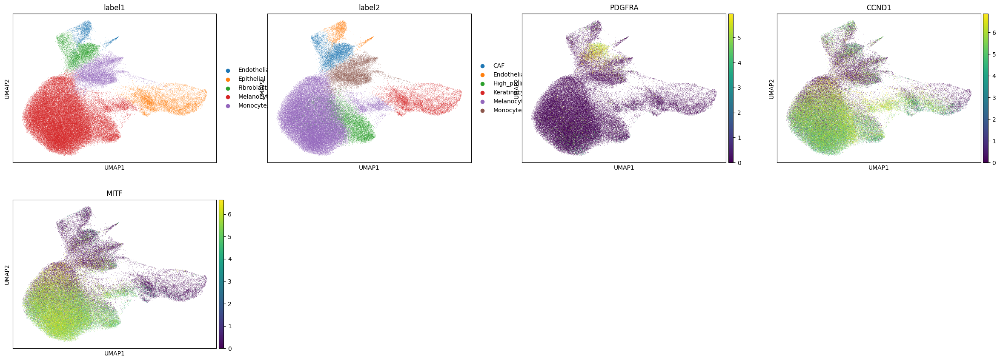

In [97]:
sc.pl.umap(adata, color=['label1', 'label2'] + genes_cancer, vmax="p99", vmin=0, ncols=4)

In [4]:
# Cancer cells
adata.obs['label3'] = 'normal_cell'
adata.obs.loc[adata.obs['label1'].isin(['Melanocyte']), 'label3'] = 'cancer_cell'

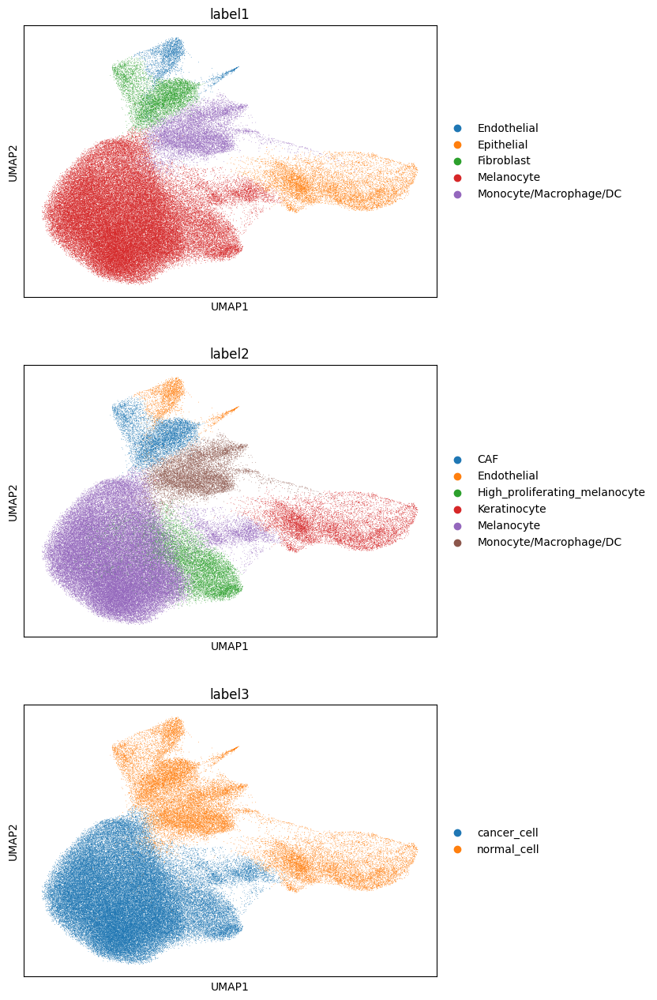

In [5]:
sc.pl.umap(adata, color=['label1', 'label2', 'label3'], ncols=1)

## 7. Save

In [6]:
adata.obs

,region,slide,cell_id,area,ct_tangram,transcript_counts,pca_n10_pcs16_leiden_res0.2,pca_n10_pcs16_leiden_res0.4,pca_n10_pcs16_leiden_res0.6,refine_res,label1,label2,label3
aaaaaaac-1,nucleus_boundaries,morpho,aaaaaaac-1,42.537377,Mast cell,175,2,4,8,4,Epithelial,Keratinocyte,normal_cell
aaaaaaad-1,nucleus_boundaries,morpho,aaaaaaad-1,14.901764,APCDD1 fibroblast,33,0,3,1,3,Melanocyte,High_proliferating_melanocyte,cancer_cell
aaaaaaaf-1,nucleus_boundaries,morpho,aaaaaaaf-1,20.546308,Granular keratinocyte,27,2,4,8,4,Epithelial,Keratinocyte,normal_cell
aaaaaaah-1,nucleus_boundaries,morpho,aaaaaaah-1,29.465128,WISP2 fibroblast,80,1,5,7,5,Fibroblast,CAF,normal_cell
aaaaaaai-1,nucleus_boundaries,morpho,aaaaaaai-1,17.565349,MMP1 fibroblast,17,1,5,7,5,Fibroblast,CAF,normal_cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...
aaabkbno-1,nucleus_boundaries,morpho,aaabkbno-1,19.665156,MMP1 fibroblast,24,1,5,7,5,Fibroblast,CAF,normal_cell
aaabkbnp-1,nucleus_boundaries,morpho,aaabkbnp-1,22.510450,Naive B,46,2,4,8,4,Epithelial,Keratinocyte,normal_cell
aaabkboa-1,nucleus_boundaries,morpho,aaabkboa-1,10.363265,Basal keratinocyte,25,2,4,8,4,Epithelial,Keratinocyte,normal_cell
aaabkboc-1,nucleus_boundaries,morpho,aaabkboc-1,13.501725,APOE fibroblast,17,1,5,7,5,Fibroblast,CAF,normal_cell


In [7]:
adata.write_h5ad(f"/Volumes/DD_FGS/MICS/data_HE2CellType/CT_DS/adata_refine_tangram/adata_refine_tangram_{slide_id}.h5ad")
# adata = sc.read_h5ad(f"/Volumes/DD_FGS/MICS/data_HE2CellType/CT_DS/adata_refine_tangram/adata_refine_tangram_{slide_id}.h5ad")